In [426]:
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2


In [427]:
targetPart = "vision_windscreen_rear"

In [428]:
labelDfCsv = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/windscreen_rear_Rear View_img_labels.csv"
labelDf = pd.read_csv(labelDfCsv)


In [429]:
partAum = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels/aum_values.csv"
partAumDf = pd.read_csv(partAum)
partAumDf.sort_values(by="aum", ascending=True, inplace=True)

In [430]:
partAumDf["CaseID"] = partAumDf.apply(lambda x : int(x["sample_id"].split("_")[0]), axis=1)

In [431]:
partAumDf = partAumDf.merge(labelDf, on="CaseID")

In [432]:
partAumDf

,sample_id,aum,CaseID,Unnamed: 0,vision_windscreen_rear,view,filename,url
0,10608430_469144192.JPG,-4.076660,10608430,3578,0,Rear View,10608430_469144192.JPG,http://192.168.1.4:8888/buckets/raw_imgs/10608...
1,11084800_492719675.JPG,-4.072070,11084800,8073,1,Rear View,11084800_492719675.JPG,http://192.168.1.4:8888/buckets/raw_imgs/11084...
2,11971797_537515831.JPG,-3.379297,11971797,5770,0,Rear View,11971797_537515831.JPG,http://192.168.1.4:8888/buckets/raw_imgs/11971...
3,10991546_487231810.JPG,-2.957227,10991546,7278,1,Rear View,10991546_487231810.JPG,http://192.168.1.4:8888/buckets/raw_imgs/10991...
4,12083379_543519078.JPG,-2.955664,12083379,8565,1,Rear View,12083379_543519078.JPG,http://192.168.1.4:8888/buckets/raw_imgs/12083...
...,...,...,...,...,...,...,...,...
7459,13344553_610915299.JPG,7.234570,13344553,3498,1,Rear View,13344553_610915299.JPG,http://192.168.1.4:8888/buckets/raw_imgs/13344...
7460,12681196_575456470.JPG,7.235938,12681196,7326,1,Rear View,12681196_575456470.JPG,http://192.168.1.4:8888/buckets/raw_imgs/12681...
7461,11675637_522970878.JPG,7.238086,11675637,8623,1,Rear View,11675637_522970878.JPG,http://192.168.1.4:8888/buckets/raw_imgs/11675...
7462,12532688_568892612.JPG,7.367188,12532688,7741,1,Rear View,12532688_568892612.JPG,http://192.168.1.4:8888/buckets/raw_imgs/12532...


In [433]:
  
evalTransform = A.Compose(
        [
            A.LongestMaxSize(480),
            A.PadIfNeeded(
                min_height=480,
                min_width=480,
                border_mode=0,
            ),
            A.Normalize(mean=[0,0,0], std=[1,1,1]),
            ToTensorV2(),
        ]
    )
def display_label_img_aug(filename, label, aum, ood=0):
    plt.title(f"Gt : {label} AUM :{aum} ood : {ood}")
    srcImgsDir = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/imgs"
    path = os.path.join( srcImgsDir, filename)
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    output=evalTransform(image=img)
    img = output["image"]
    img = img.swapaxes(0, 1)
    img = img.swapaxes(1, 2)
    plt.axis('off')
    plt.imshow(img)

In [434]:


def display_label_img(filename, label, aum, ood=0):
    plt.title(f"Gt : {label} AUM :{aum} ood : {ood}")
    srcImgsDir = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/imgs"
    path = os.path.join( srcImgsDir, filename)
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.axis('off')
    plt.imshow(img)

In [435]:

def view_samples(samples):
    fig = plt.figure(figsize=(60, 80))
    maxRows = len(samples)

    for i,info in enumerate(samples, start=1):
        fig.add_subplot(
                maxRows,
                1,
                i,
            )
        display_label_img_aug(info["filename"], info["gt_label"], info["aum"], info["ood_score"])

In [436]:
worstSampleToView = []
topN = 20
for i in range(topN):
    row = partAumDf.iloc[i]
    worstSampleToView.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })


In [437]:
bestSampleToView = []
for i in range(topN):
    row = partAumDf.iloc[-(i + 1)]
    bestSampleToView.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })


In [438]:
hardestSampleToView = []
medianAUM = partAumDf["aum"].median()

leftHalfDf = partAumDf[partAumDf["aum"] < medianAUM].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= medianAUM].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    hardestSampleToView.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [439]:
hardQuarterSamples = []
q1AUM = partAumDf["aum"].quantile(0.25)

leftHalfDf = partAumDf[partAumDf["aum"] < q1AUM].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= q1AUM].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    hardQuarterSamples.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [440]:
easyQuarterSamples = []
q1AUM = partAumDf["aum"].quantile(0.75)

leftHalfDf = partAumDf[partAumDf["aum"] < q1AUM].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= q1AUM].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    easyQuarterSamples.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [441]:
aroundZeroDf = []
aroundZeroAum = 0.0

leftHalfDf = partAumDf[partAumDf["aum"] < aroundZeroAum].sort_values(by="aum", ascending=False).head(topN // 2)
rightHalfDf = partAumDf[partAumDf["aum"] >= aroundZeroAum].sort_values(by="aum", ascending=True).head(topN // 2)
hardAumDf = pd.concat([leftHalfDf, rightHalfDf])
for i in range(topN):
    row = hardAumDf.iloc[-(i + 1)]
    aroundZeroDf.append({
        "filename" : row["sample_id"],
        "gt_label" : row[targetPart],
        "ood_score" : 0,

        "aum" : row["aum"],

    })

In [442]:
import plotly.express as px

fig = px.histogram(partAumDf, x="aum")
medianAum = partAumDf["aum"].median()
q1Aum = partAumDf["aum"].quantile(0.25)
q3Aum = partAumDf["aum"].quantile(0.75)
q30Aum = partAumDf["aum"].quantile(0.3)
q30Aum = partAumDf["aum"].quantile(0.3)

fig.add_vline(x=q1Aum, line_width=2, line_color="red")
fig.add_vline(x=medianAum, line_width=2, line_color="purple")
fig.add_vline(x=q3Aum, line_width=2, line_color="green")
fig.add_vline(x=q30Aum, line_width=2, line_color="green")

fig.update_layout(
    xaxis = dict(
        tickmode = 'array',
        tickvals = [-0.5, 0,q1Aum, medianAum, q3Aum,q30Aum, 6, 8],
    )
)

In [443]:
# view_samples(worstSampleToView)

In [444]:
selectedCsv = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels/selected.csv"

In [445]:
selectedDf = pd.read_csv(selectedCsv)

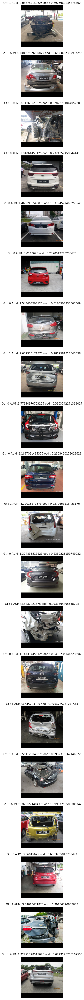

In [446]:
afterSelections = []
randomSamples= selectedDf.sample(20)
for _, row in randomSamples.iterrows():
    afterSelections.append({
        "filename" : row["sample_id"],
        "gt_label" : row["gt"],
        "aum" : row["aum"],
        "ood_score" : row["ood_score"],

    })
view_samples(afterSelections)

In [447]:
oriDf = pd.read_csv("/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels/all_info_before_select.csv")
oriDf

,Unnamed: 0.1,Unnamed: 0,pred,gt,probs_0,probs_1,filename,dataset_index,ood_score,sample_id,aum
0,0,0,0,0,0.563918,0.436082,10245749_449665842.JPG,0,0.002596,10245749_449665842.JPG,0.885913
1,1,1,0,0,0.897606,0.102394,10116212_446431689.JPG,0,0.374356,10116212_446431689.JPG,1.431659
2,2,2,1,1,0.002107,0.997893,13168961_602493571.JPG,0,0.979359,13168961_602493571.JPG,4.761133
3,3,3,1,1,0.121425,0.878575,12296957_554757469.JPG,0,0.487785,12296957_554757469.JPG,-0.161774
4,4,4,0,0,0.971645,0.028355,10109664_443680971.JPG,0,0.574225,10109664_443680971.JPG,2.098242
...,...,...,...,...,...,...,...,...,...,...,...
10325,10325,95,1,1,0.001014,0.998986,13075001_596108579.JPG,2,0.989060,NaN,NaN
10326,10326,96,1,1,0.316792,0.683208,12587320_571495130.JPG,2,0.121503,NaN,NaN
10327,10327,97,1,1,0.000684,0.999316,11714155_524750875.JPG,2,0.992258,NaN,NaN
10328,10328,98,1,1,0.004191,0.995809,12456398_563516398.JPG,2,0.962868,NaN,NaN


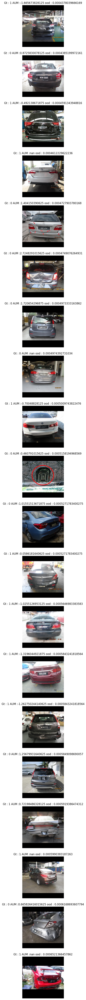

In [448]:
mostOodSamples = []
oodDf= oriDf.sort_values(by="ood_score", ascending=True).iloc[100:].head(20)
for _, row in oodDf.iterrows():
    mostOodSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["aum"],
        "ood_score" : row["ood_score"],

    })
view_samples(mostOodSamples)

In [449]:
cleanTrainDf = pd.read_csv("/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum/windscreen_rear_Rear View_img_labels_clean/pred_cleaned_windscreen_rear_Rear View_img_labels.csv")
cleanTrainDf= cleanTrainDf[cleanTrainDf["dataset_index"] == 2]

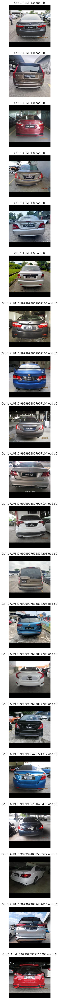

In [450]:
afterSelectionFNSamples = []
FNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0)].sort_values(by="probs_0", ascending=False).head(20)
for _, row in FNSamples.iterrows():
    afterSelectionFNSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_0"],
        "ood_score" : row["pred"],

    })
view_samples(afterSelectionFNSamples)

In [451]:
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1) & (cleanTrainDf["dataset_index"] == 2)]
fpr = len(FPSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 0) & (cleanTrainDf["dataset_index"] == 2)])
fpr

0.088

In [452]:
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1) & (cleanTrainDf["dataset_index"] == 2) 
& (cleanTrainDf["probs_1"] >= 0.7)]
true_fpr = len(FPSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 0) & (cleanTrainDf["dataset_index"] == 2)])
true_fpr

0.076

In [453]:
FNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["dataset_index"] == 2)]
fnr = len(FNSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 1) & (cleanTrainDf["dataset_index"] == 2)])
fnr

0.33

In [454]:
FNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["dataset_index"] == 2) 
& (cleanTrainDf["probs_0"] >= 0.7)]
true_fnr = len(FNSamples) / len(cleanTrainDf[(cleanTrainDf["gt"] == 1) & (cleanTrainDf["dataset_index"] == 2)])
true_fnr

0.314

In [455]:

afterSelectionFPSamples = []
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1)].sort_values(by="probs_1", ascending=False).head(20)
for _, row in FPSamples.iterrows():
    afterSelectionFPSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_1"],
        "ood_score" : row["pred"],

    })
# view_samples(afterSelectionFPSamples)

In [456]:
afterSelectionTNSamples = []
TNSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 0)].sort_values(by="probs_0", ascending=False).head(20)
for _, row in TNSamples.iterrows():
    afterSelectionTNSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_0"],
        "ood_score" : row["pred"],

    })
# view_samples(afterSelectionTNSamples)

In [457]:
afterSelectionTPSamples = []
TPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 1)].sort_values(by="probs_1", ascending=False).head(20)
for _, row in TPSamples.iterrows():
    afterSelectionTPSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_1"],
        "ood_score" : row["pred"],

    })
# view_samples(afterSelectionTPSamples)

In [458]:

afterSelectionFPSamples = []
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 0 )& (cleanTrainDf["pred"] == 1) & (cleanTrainDf["probs_1"] >= 0.7)].sort_values(by="probs_1", ascending=True).head(20)
for _, row in FPSamples.iterrows():
    afterSelectionFPSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_1"],
        "ood_score" : row["pred"],

    })
# view_samples(afterSelectionFPSamples)

In [459]:
afterSelectionFNSamples = []
FPSamples= cleanTrainDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["probs_0"] >= 0.7)].sort_values(by="probs_0", ascending=True).head(20)
for _, row in FPSamples.iterrows():
    afterSelectionFNSamples.append({
        "filename" : row["filename"],
        "gt_label" : row["gt"],
        "aum" : row["probs_0"],
        "ood_score" : row["pred"],

    })
# view_samples(afterSelectionFNSamples)

In [460]:
interCsv = "/home/alextay96/Desktop/all_workspace/new_workspace/DLDataPipeline/data/build_dataset/aum_v2/fender_front_lh_Front View Left_img_labels_clean/pred_cleaned_fender_front_lh_Front View Left_img_labels.csv"
interDf = pd.read_csv(interCsv)
interDf= interDf[interDf["dataset_index"] == 1]

In [461]:
interDf

,Unnamed: 0,pred,gt,probs_0,probs_1,filename,dataset_index
1577,0,0,0,0.979629,0.020371,11279789_502045403.JPG,1
1578,1,1,1,0.000187,0.999813,10439381_460024176.JPG,1
1579,2,1,1,0.008728,0.991272,10098557_442239889.JPG,1
1580,3,1,1,0.000004,0.999996,10054036_440195485.JPG,1
1581,4,1,1,0.000075,0.999925,11794935_528520916.JPG,1
...,...,...,...,...,...,...,...
1748,21,1,1,0.000084,0.999915,10730987_474889229.JPG,1
1749,22,1,1,0.000029,0.999971,12863671_585174805.JPG,1
1750,23,0,0,0.888324,0.111676,10223037_448545859.JPG,1
1751,24,0,0,0.985072,0.014928,13478363_615456649.JPG,1


In [462]:
selectedSamples = []
predPosDf = interDf[(interDf["pred"] == 0) & (interDf["gt"] == 0)].sort_values(by="probs_0", ascending=False).iloc[0:].head(20)
predPosDf2 = interDf[(interDf["pred"] == 0) & (interDf["gt"] == 0)].sort_values(by="probs_0", ascending=False).iloc[20:].head(20)
predPosDf3 = interDf[(interDf["pred"] == 0) & (interDf["gt"] == 0)].sort_values(by="probs_0", ascending=False).iloc[40:].head(20)

allDf = [predPosDf, predPosDf2, predPosDf3]
# predPosDf= predPosDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["probs_0"] >= 0.7)].sort_values(by="probs_0", ascending=True).head(20)
for df in allDf:
    selectedSamples = []
    for _, row in df.iterrows():
        selectedSamples.append({
            "filename" : row["filename"],
            "gt_label" : row["gt"],
            "aum" : row["probs_0"],
            "ood_score" : row["pred"],

        })
    # view_samples(selectedSamples)

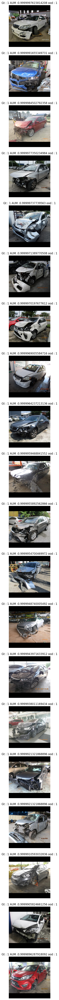

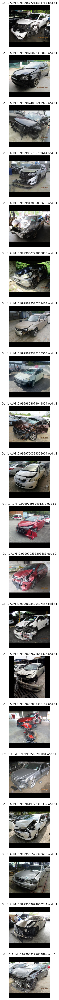

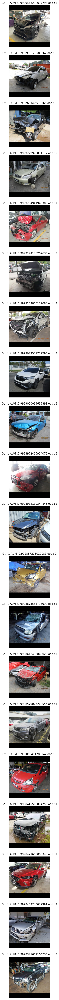

In [463]:
selectedSamples = []
predPosDf = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 1)].sort_values(by="probs_1", ascending=False).iloc[0:].head(20)
predPosDf2 = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 1)].sort_values(by="probs_1", ascending=False).iloc[20:].head(20)
predPosDf3 = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 1)].sort_values(by="probs_1", ascending=False).iloc[40:].head(20)

allDf = [predPosDf, predPosDf2, predPosDf3]
# predPosDf= predPosDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["probs_0"] >= 0.7)].sort_values(by="probs_0", ascending=True).head(20)
for df in allDf:
    selectedSamples = []
    for _, row in df.iterrows():
        selectedSamples.append({
            "filename" : row["filename"],
            "gt_label" : row["gt"],
            "aum" : row["probs_1"],
            "ood_score" : row["pred"],

        })
    view_samples(selectedSamples)

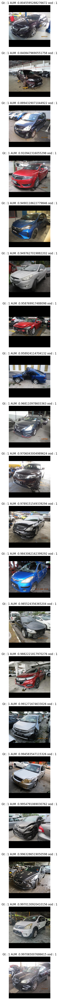

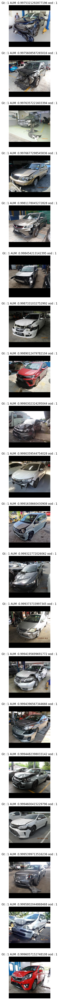

In [464]:
selectedSamples = []
predPosDf = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 1)].sort_values(by="probs_1", ascending=True).iloc[0:].head(20)
predPosDf2 = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 1)].sort_values(by="probs_1", ascending=True).iloc[20:].head(20)
# predPosDf3 = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 1)].sort_values(by="probs_1", ascending=False).iloc[40:].head(20)

allDf = [predPosDf, predPosDf2]
# predPosDf= predPosDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["probs_0"] >= 0.7)].sort_values(by="probs_0", ascending=True).head(20)
for df in allDf:
    selectedSamples = []
    for _, row in df.iterrows():
        selectedSamples.append({
            "filename" : row["filename"],
            "gt_label" : row["gt"],
            "aum" : row["probs_1"],
            "ood_score" : row["pred"],

        })
    view_samples(selectedSamples)

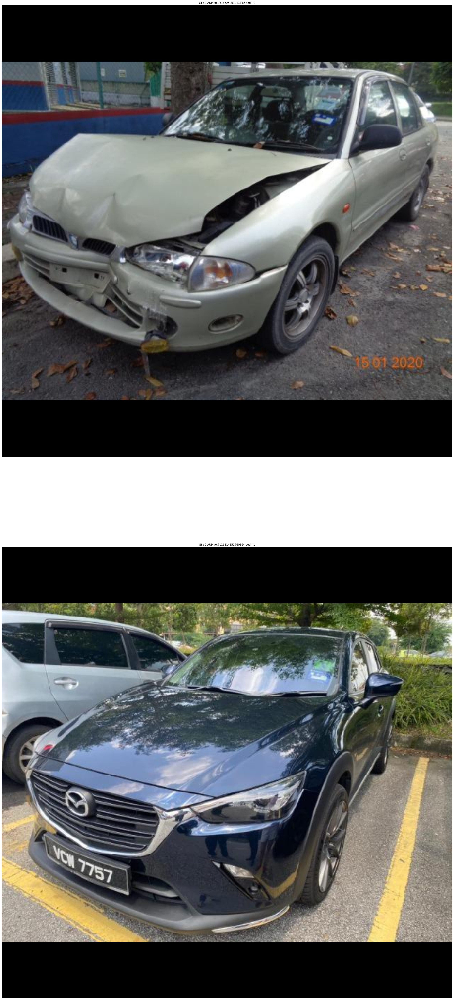

<Figure size 6000x8000 with 0 Axes>

In [465]:
selectedSamples = []
predPosDf = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 0)].sort_values(by="probs_1", ascending=False).iloc[0:].head(20)
predPosDf2 = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 0)].sort_values(by="probs_1", ascending=False).iloc[20:].head(20)
# predPosDf3 = interDf[(interDf["pred"] == 1) & (interDf["gt"] == 0)].sort_values(by="probs_1", ascending=False).iloc[40:].head(20)

allDf = [predPosDf, predPosDf2]
# predPosDf= predPosDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["probs_0"] >= 0.7)].sort_values(by="probs_0", ascending=True).head(20)
for df in allDf:
    selectedSamples = []
    for _, row in df.iterrows():
        selectedSamples.append({
            "filename" : row["filename"],
            "gt_label" : row["gt"],
            "aum" : row["probs_1"],
            "ood_score" : row["pred"],

        })
    view_samples(selectedSamples)

In [466]:
selectedSamples = []
predPosDf = interDf[(interDf["pred"] == 0) & (interDf["gt"] == 1)].sort_values(by="probs_0", ascending=False).iloc[0:].head(20)
predPosDf2 = interDf[(interDf["pred"] == 0) & (interDf["gt"] == 1)].sort_values(by="probs_0", ascending=False).iloc[20:].head(20)
# predPosDf3 = interDf[(interDf["pred"] == 0) & (interDf["gt"] == 1)].sort_values(by="probs_0", ascending=False).iloc[40:].head(20)

allDf = [predPosDf, predPosDf2]
# predPosDf= predPosDf[(cleanTrainDf["gt"] == 1 )& (cleanTrainDf["pred"] == 0) & (cleanTrainDf["probs_0"] >= 0.7)].sort_values(by="probs_0", ascending=True).head(20)
for df in allDf:
    selectedSamples = []
    for _, row in df.iterrows():
        selectedSamples.append({
            "filename" : row["filename"],
            "gt_label" : row["gt"],
            "aum" : row["probs_0"],
            "ood_score" : row["pred"],

        })
    view_samples(selectedSamples)

<Figure size 6000x8000 with 0 Axes>

<Figure size 6000x8000 with 0 Axes>